# STRUCTURE FROM MOTION - 3D RECONSTRUCTION

In [21]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm
import os
import gtsam
import gtsam.utils.plot
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
import plotly.graph_objs as go
from plotly.subplots import make_subplots 
import math

### Load Images & Feature Matching

In [2]:
def load_images_from_folder(folder_path): 
    """Load all images from the specified folder"""
    images = []  # Initialize a list to store loaded images
    
    # Gather all image files with specified extensions in the folder
    image_files = [file for file in os.listdir(folder_path) if file.lower().endswith(('png', 'jpg', 'jpeg', 'bmp', 'tif'))]
        
    # Raise an error if no image files are found
    if not image_files:
        raise ValueError(f"No images found in the folder: {folder_path}")
    
    # Load each image file and append to the images list 
    for filename in image_files:
        img_path = os.path.join(folder_path, filename)
        image = cv2.imread(img_path)
        if image is not None:
            images.append((filename, image))  # Store the filename and image
        else:
            print(f"Warning: {filename} could not be loaded.")  # Log a warning for any failed loads
    
    return images  # Return the list of loaded images 

I have removed Image 2 & 3 from the dataset. Due to these images, the triangulation and pose recovery process was getting affected. This is because there is almost no change from Image 1 to Image 2. Between Image 2 & 3, there is just a slight horizontal shift. Depth estimation fails in these cases as we need some rotational movement between different views to triangulate depth and the 3D points. 

In [3]:
# Replace with the path to your folder containing the Buddha images
folder_path = 'buddha_images' 
images = load_images_from_folder(folder_path) 

# Extract image arrays into a separate variable
image = [img[1] for img in images]
print("Number of images loaded:", len(image)) 

# Extract height and width from the first image in the list
image_height, image_width, _ = image[0].shape

# Intrinsic camera matrix K. Setting the Focal Length to be equal to Image Width, and the 
# Principal Focus to be equal to (Image Dimension / 2). 
K = np.array([[image_width, 0, image_width / 2],
              [0, image_width, image_height / 2],
              [0, 0, 1]]) 

print(K) 

Number of images loaded: 22
[[1.08e+03 0.00e+00 5.40e+02]
 [0.00e+00 1.08e+03 9.60e+02]
 [0.00e+00 0.00e+00 1.00e+00]]


In [4]:
def find_matches(images):
    ''' Detects and matches SIFT keypoints between consecutive images. '''
    # Initialize the SIFT detector with specified parameters
    sift_detector = cv2.SIFT_create(nfeatures=5000, nOctaveLayers=16, contrastThreshold=0.025, edgeThreshold=10, sigma=1.5)

    # Set up the FLANN matcher for fast nearest neighbor search
    flann_index = 1
    index_parameters = dict(algorithm=flann_index, trees=5)
    search_parameters = dict(checks=50)

    flann_matcher = cv2.FlannBasedMatcher(index_parameters, search_parameters)

    # Lists to store results for all image pairs
    matched_points = []  # List to store matched points between image pairs
    keypoints1_list = []  # List to store keypoints for image1 in each pair
    keypoints2_list = []  # List to store keypoints for image2 in each pair
    good_points1_indices = []  # List to store indices of good points in image1
    good_points2_indices = []  # List to store indices of good points in image2

    # Iterate through the list of images to find matches
    for idx in range(len(images) - 1):
        # Convert images to grayscale for SIFT processing
        gray1 = cv2.cvtColor(images[idx], cv2.COLOR_BGR2GRAY)
        gray2 = cv2.cvtColor(images[idx + 1], cv2.COLOR_BGR2GRAY)

        # Detect keypoints and compute descriptors for both images
        keypoints1, descriptors1 = sift_detector.detectAndCompute(gray1, mask=None)
        keypoints2, descriptors2 = sift_detector.detectAndCompute(gray2, mask=None)

        # Use KNN to find matches between descriptors
        knn_matches = flann_matcher.knnMatch(descriptors1, descriptors2, k=2)

        # Filter matches using the Lowe's ratio test to retain good matches
        filtered_matches = [m for m, n in knn_matches if m.distance < 0.7 * n.distance]

        # Extract matched points and their indices
        points1 = np.float32([keypoints1[m.queryIdx].pt for m in filtered_matches])
        points2 = np.float32([keypoints2[m.trainIdx].pt for m in filtered_matches])
        indices1 = [m.queryIdx for m in filtered_matches]  # Indices of good points in image1
        indices2 = [m.trainIdx for m in filtered_matches]  # Indices of good points in image2

        # Store results
        matched_points.append((points1, points2))  # Store matched points
        keypoints1_list.append(keypoints1)  # Store keypoints for image1
        keypoints2_list.append(keypoints2)  # Store keypoints for image2
        good_points1_indices.append(np.array(indices1))  # Store indices for image1
        good_points2_indices.append(np.array(indices2))  # Store indices for image2

        # Print the number of matches found for the current image pair
        print(f"Images: {idx+1} and {idx+2} - Matches found: {len(points1)}")

    return matched_points, keypoints1_list, keypoints2_list, good_points1_indices, good_points2_indices


In [5]:
# # Match features between all the images in the dataset
matches, k1, k2, gp1, gp2 = find_matches(image)
print(f"Number of feature match pairs: {len(matches)}")

Images: 1 and 2 - Matches found: 728
Images: 2 and 3 - Matches found: 467
Images: 3 and 4 - Matches found: 509
Images: 4 and 5 - Matches found: 654
Images: 5 and 6 - Matches found: 710
Images: 6 and 7 - Matches found: 451
Images: 7 and 8 - Matches found: 505
Images: 8 and 9 - Matches found: 491
Images: 9 and 10 - Matches found: 494
Images: 10 and 11 - Matches found: 780
Images: 11 and 12 - Matches found: 452
Images: 12 and 13 - Matches found: 342
Images: 13 and 14 - Matches found: 722
Images: 14 and 15 - Matches found: 693
Images: 15 and 16 - Matches found: 787
Images: 16 and 17 - Matches found: 807
Images: 17 and 18 - Matches found: 770
Images: 18 and 19 - Matches found: 939
Images: 19 and 20 - Matches found: 908
Images: 20 and 21 - Matches found: 739
Images: 21 and 22 - Matches found: 594
Number of feature match pairs: 21


### Fundamental Matrix Calculation

This is the methodology I have followed for fundamental matrix estimation:

1. **Point Normalization**: Normalizing 2D points ensures numerical stability for fundamental matrix estimation. Points are shifted to have a mean of zero and scaled by $(\sqrt{2})$, using a transformation matrix  T, calculated as:
   
   $T = \begin{bmatrix} \frac{\sqrt{2}}{\sigma_x} & 0 & -\frac{\sqrt{2}\mu_x}{\sigma_x} \\ 0 & \frac{\sqrt{2}}{\sigma_y} & -\frac{\sqrt{2}\mu_y}{\sigma_y} \\ 0 & 0 & 1 \end{bmatrix}$
   

2. **Fundamental Matrix Estimation (8-point algorithm)**: The fundamental matrix F  relates corresponding points in two views, satisfying:
   
   $\mathbf{x}_2^T F \mathbf{x}_1 = 0$
   
   Using normalized points, a system of equations $( Af = 0 )$ is formed, solved via SVD of  A.


3. **Rank-2 Constraint**: The estimated F is adjusted to rank 2 by setting the smallest singular value to zero:
   
   $F = U \cdot \text{diag}(S) \cdot V^T, \quad S[2] = 0$
   

4. **Denormalization**: The normalized F is denormalized using the transformations $( T_1 )$ and $( T_2 )$:
   
   $F = T_2^T \cdot F \cdot T_1$
   

5. **Sampson Distance**: Used as a geometric error measure for point correspondence, it approximates reprojection error:
   
   $d = \frac{(\mathbf{x}_2^T F \mathbf{x}_1)^2}{(F \mathbf{x}_1)^2_{x} + (F \mathbf{x}_1)^2_{y} + (F^T \mathbf{x}_2)^2_{x} + (F^T \mathbf{x}_2)^2_{y}}$
   

6. **RANSAC**: Robustly estimates F by iteratively sampling 8 random points, estimating F, and evaluating inliers using the Sampson distance.

7. **Confidence and Thresholding**: Inliers are points whose Sampson distance is below a threshold. Iteration stops early if sufficient inliers are found to meet the confidence level.

8. **Final Estimation**: The best F is recomputed using all inliers for higher accuracy.

9. **Masking**: A binary mask is created to indicate inliers (1) and outliers (0) for further processing.

10. **Output**: Returns F, the inlier mask, and the inlier points from both views, supporting robust epipolar geometry computation.

In [6]:
##### THESE ARE THE FUNCTIONS USED IN FUNDAMENTAL MATRIX CALCULATION. SINCE I AM NOT USING THE OPENCV FUNCTION cv2.findFundamentalMat,  
##### I HAVE DEVELOPED THIS FUNDAMENTAL MATRIX CODE FROM SCRATCH.  


def normalize_points(pts):
    """ Normalizes a set of 2D points for numerical stability. """
    # Calculate mean and standard deviation for normalization
    mean = np.mean(pts, axis=0)
    std_dev = np.std(pts, axis=0)

    # Compute the normalization transformation matrix
    scale = np.sqrt(2) / std_dev
    T = np.array([[scale[0], 0, -scale[0] * mean[0]],
                  [0, scale[1], -scale[1] * mean[1]],
                  [0, 0, 1]])

    # Apply the transformation to normalize the points
    pts_normalized = np.dot(T, np.hstack((pts, np.ones((pts.shape[0], 1)))).T).T
    return pts_normalized, T

def fundamental_matrix_8point(pts1, pts2):
    """ Computes the fundamental matrix using the 8-point algorithm with normalization. """
    # Normalize the input points
    pts1, T1 = normalize_points(pts1)
    pts2, T2 = normalize_points(pts2)

    # Construct matrix A for the equation Af = 0
    A = np.zeros((pts1.shape[0], 9))
    for i in range(pts1.shape[0]):
        x1, y1 = pts1[i][0], pts1[i][1]
        x2, y2 = pts2[i][0], pts2[i][1]
        A[i] = [x2 * x1, x2 * y1, x2, y2 * x1, y2 * y1, y2, x1, y1, 1]

    # Perform SVD to solve for the fundamental matrix
    _, _, V = np.linalg.svd(A)
    F = V[-1].reshape(3, 3)

    # Apply rank-2 constraint to the fundamental matrix
    U, S, V = np.linalg.svd(F)
    S[2] = 0  # Set the smallest singular value to zero
    F = np.dot(U, np.dot(np.diag(S), V))

    # Denormalize the fundamental matrix
    F = np.dot(T2.T, np.dot(F, T1))
    
    return F / F[2, 2] 

def sampson_distance(F, pts1, pts2):
    """ Calculate the Sampson distance for error measurement. """
    # Prepare homogeneous coordinates for the points
    pts1_h = np.hstack((pts1, np.ones((pts1.shape[0], 1))))
    pts2_h = np.hstack((pts2, np.ones((pts2.shape[0], 1))))
    
    # Compute epipolar constraints
    Fx1 = np.dot(F, pts1_h.T).T
    Fx2 = np.dot(F.T, pts2_h.T).T
    
    # Calculate the numerator and denominator for the Sampson distance
    numerator = (pts2_h * Fx1).sum(axis=1) ** 2
    denominator = Fx1[:, 0]**2 + Fx1[:, 1]**2 + Fx2[:, 0]**2 + Fx2[:, 1]**2
    return numerator / denominator 

def ransac_fundamental_matrix(pts1, pts2, num_iters=1000, threshold=1.0, confidence=0.99):
    """ Estimate the fundamental matrix using the RANSAC algorithm. """
    best_inliers = []  # To track the best set of inliers
    best_F = None      # To store the best fundamental matrix
    np.random.seed(0)  # Set a seed for reproducibility

    for _ in range(num_iters):
        # Randomly sample 8 points for the fundamental matrix estimation
        idx = np.random.choice(len(pts1), 8, replace=False)
        sample_pts1 = pts1[idx]
        sample_pts2 = pts2[idx]

        # Compute fundamental matrix from the sampled points
        F = fundamental_matrix_8point(sample_pts1, sample_pts2)

        # Determine inliers based on the Sampson distance
        sampson_errors = sampson_distance(F, pts1, pts2)
        inliers = np.where(sampson_errors < threshold)[0]

        # Update the best inliers and fundamental matrix if current is better
        if len(inliers) > len(best_inliers):
            best_inliers = inliers
            best_F = F

        # Stop early if confidence level is reached
        if len(best_inliers) >= len(pts1) * confidence:
            break

    # Recompute the fundamental matrix using all inliers for final result
    if best_inliers.size > 0:  # Check if there are inliers
        best_F = fundamental_matrix_8point(pts1[best_inliers], pts2[best_inliers])

    return best_F, best_inliers 

In [7]:
# #COMMENTED OUT THE OPENCV'S FUNDAMENTAL MATRIX CODE FOR TESTING PURPOSE

# def calculate_fundamental_matrix(points1, points2):
#     """ Estimates the fundamental matrix using OpenCV's inbuilt function """
#     F_matrix, mask = cv2.findFundamentalMat(points1, points2, cv2.FM_LMEDS, cv2.RANSAC, 1.0)
#     # Select only inlier points
#     inliers1 = points1[mask.ravel() == 1]
#     inliers2 = points2[mask.ravel() == 1]
#     return F_matrix, mask, (inliers1, inliers2)

#MY CUSTOM BUILT FUNDAMENTAL MATRIX CODE

def calculate_fundamental_matrix(pts1, pts2, method='RANSAC', ransac_threshold=1.0, confidence=0.99, max_iters=1000):
    """ Estimates the fundamental matrix using the RANSAC-based 8-point algorithm. """
    if method == 'RANSAC':
        # Use custom RANSAC implementation
        F, inliers = ransac_fundamental_matrix(pts1, pts2, num_iters=max_iters, threshold=ransac_threshold, confidence=confidence)
    else:
        # Simple 8-point algorithm without RANSAC
        F = fundamental_matrix_8point(pts1, pts2)
        inliers = np.arange(pts1.shape[0])  # All points are inliers

    # Filter inliers
    pts1_inliers = pts1[inliers]
    pts2_inliers = pts2[inliers]
    mask = np.zeros(len(pts1), dtype=np.uint8)
    mask[inliers] = 1

    return F, mask, (pts1_inliers, pts2_inliers)

### Visualization of Epipolar Lines

In [8]:
def draw_epilines(image1, image2, epilines, inlier_points1, inlier_points2):
    ''' Draw epipolar lines and corresponding points on the provided images '''
    height, width = image1.shape[:2]  # Get dimensions of the first image
    for index in range(len(epilines)):
        line = epilines[index]
        point1 = inlier_points1[index]
        point2 = inlier_points2[index]
        
        # Generate a random color for lines and circles
        random_color = np.random.randint(0, 256, size=3).tolist()
        
        # Calculate the start and end points of the epiline
        y_start = int(-line[2] / line[1])
        y_end = int(-(line[2] + line[0] * width) / line[1])
        
        # Draw the epiline and inlier points
        image1 = cv2.line(image1, (0, y_start), (width, y_end), random_color, thickness=1)
        image1 = cv2.circle(image1, tuple(map(int, point1)), radius=5, color=random_color, thickness=-1)
        image2 = cv2.circle(image2, tuple(map(int, point2)), radius=5, color=random_color, thickness=-1)
        
    return image1, image2

def display_results(image1, image2):
    ''' Create a layout to diplay the epipolar lines '''
    fig = plt.figure(figsize=(18, 10)) 
    
    # Create two axes in a horizontal arrangement
    ax1 = fig.add_subplot(121)  # Left subplot
    ax2 = fig.add_subplot(122)  # Right subplot

    # Display the first image with a specific colormap
    ax1.imshow(image1, cmap='viridis')  # Use viridis colormap for visual interest
    ax1.set_title('Left Image', fontsize=22, fontweight='bold')  # title
    ax1.axis('off')  # Hide the axis for clarity

    # Display the second image with a specific colormap
    ax2.imshow(image2, cmap='plasma')  # Use plasma colormap for visual interest
    ax2.set_title('Right Image', fontsize=22, fontweight='bold')  # title
    ax2.axis('off')  # Hide the axis for clarity

    # Set a main title for the entire figure
    fig.suptitle('Comparison of Epipolar Lines', fontsize=26, fontweight='bold', color='darkblue')

    # Adjust layout for spacing
    plt.subplots_adjust(wspace=0.3, top=0.9)
    plt.show()

Displaying epipolar lines for image pair: 1 and 2


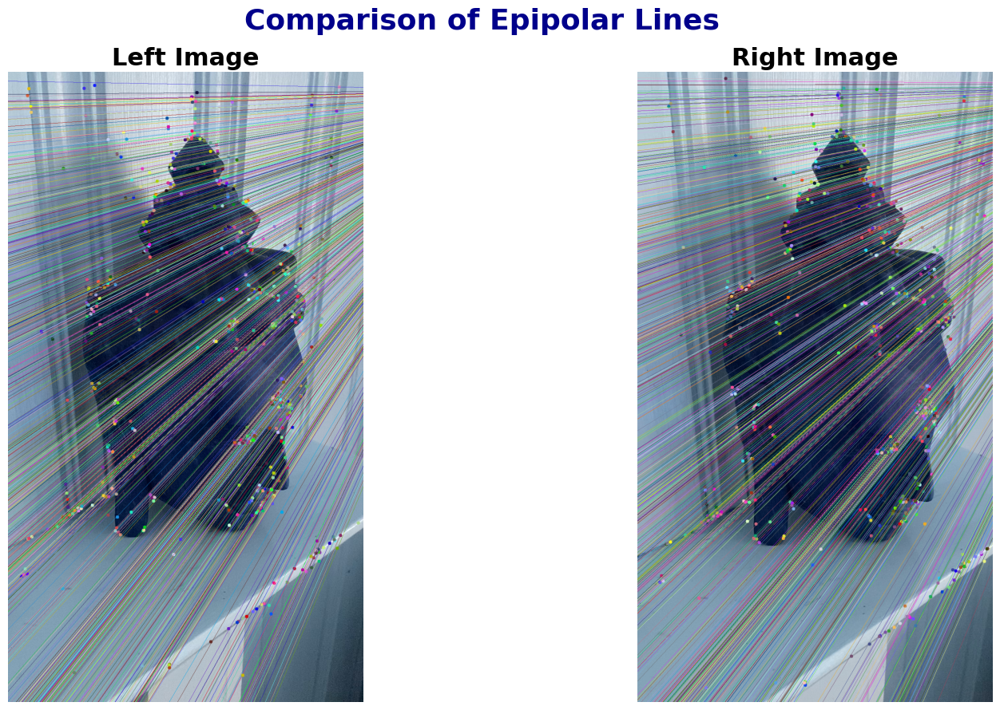

Displaying epipolar lines for image pair: 2 and 3


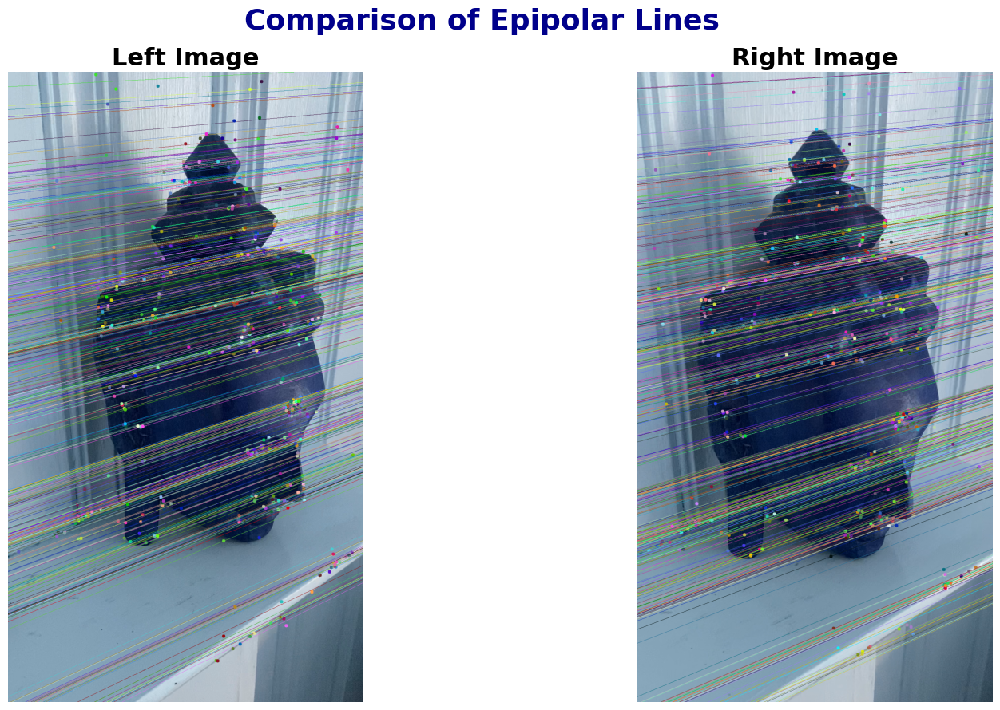

Displaying epipolar lines for image pair: 3 and 4


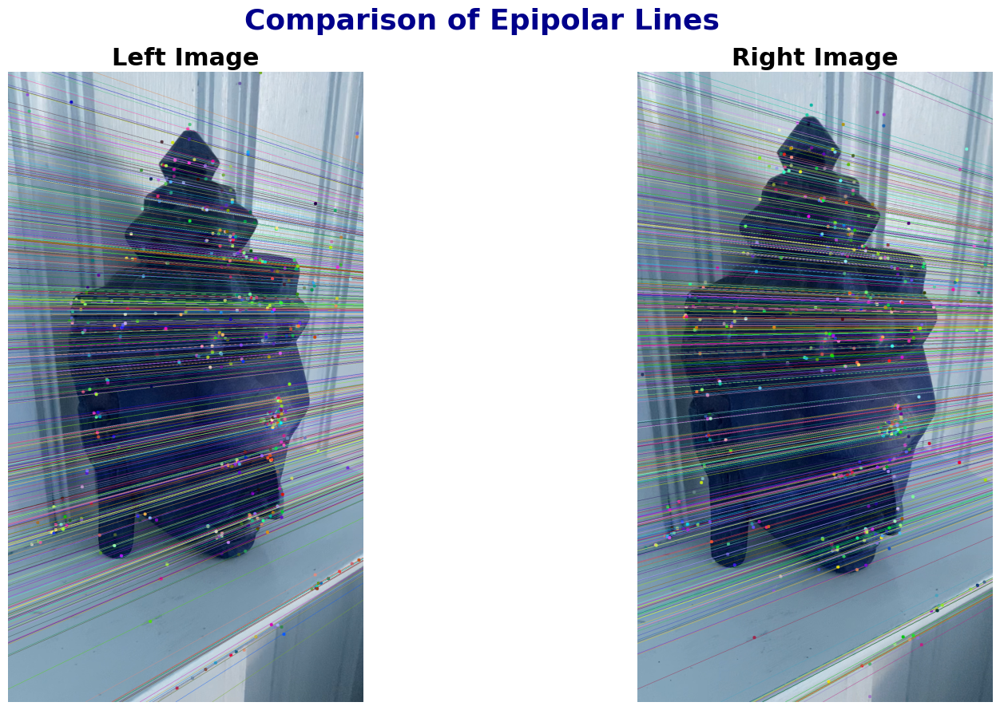

Displaying epipolar lines for image pair: 4 and 5


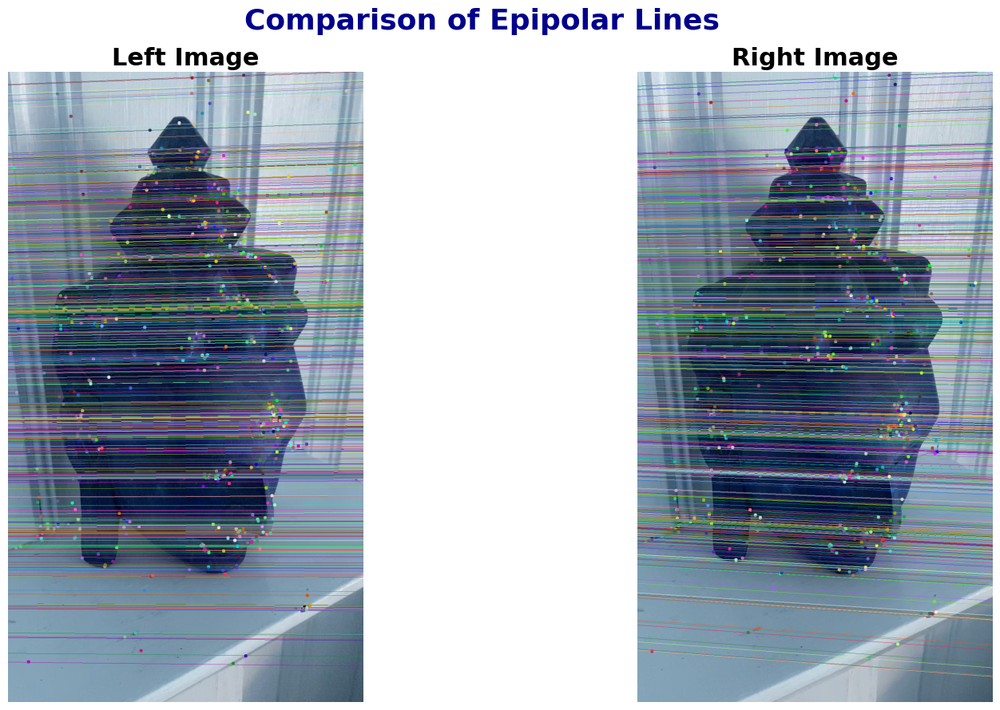

Displaying epipolar lines for image pair: 5 and 6


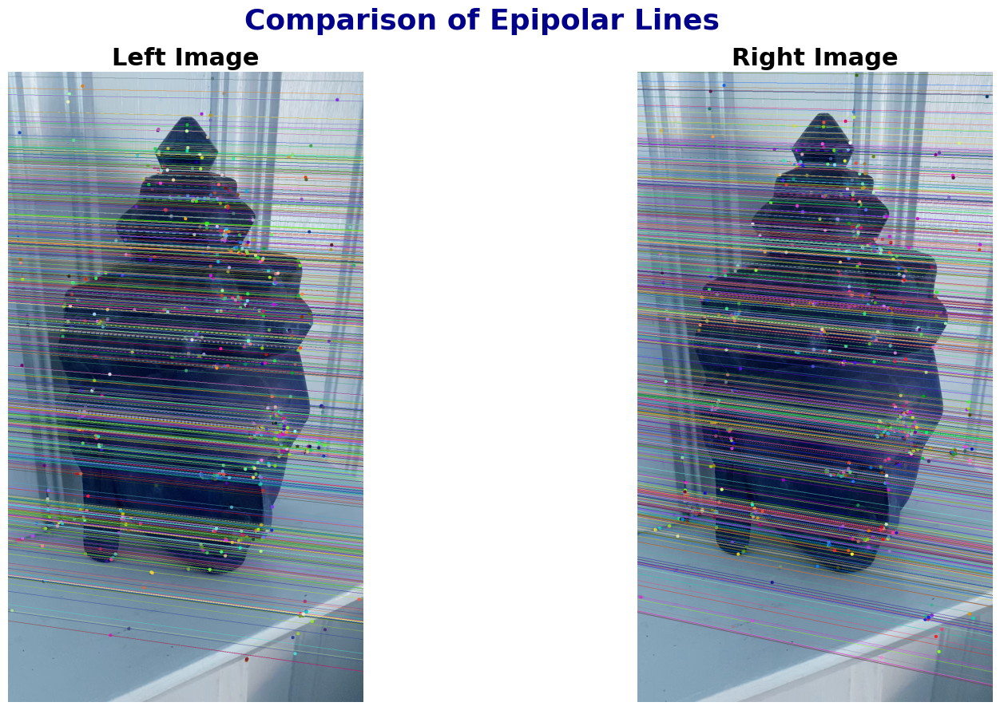

Displaying epipolar lines for image pair: 6 and 7


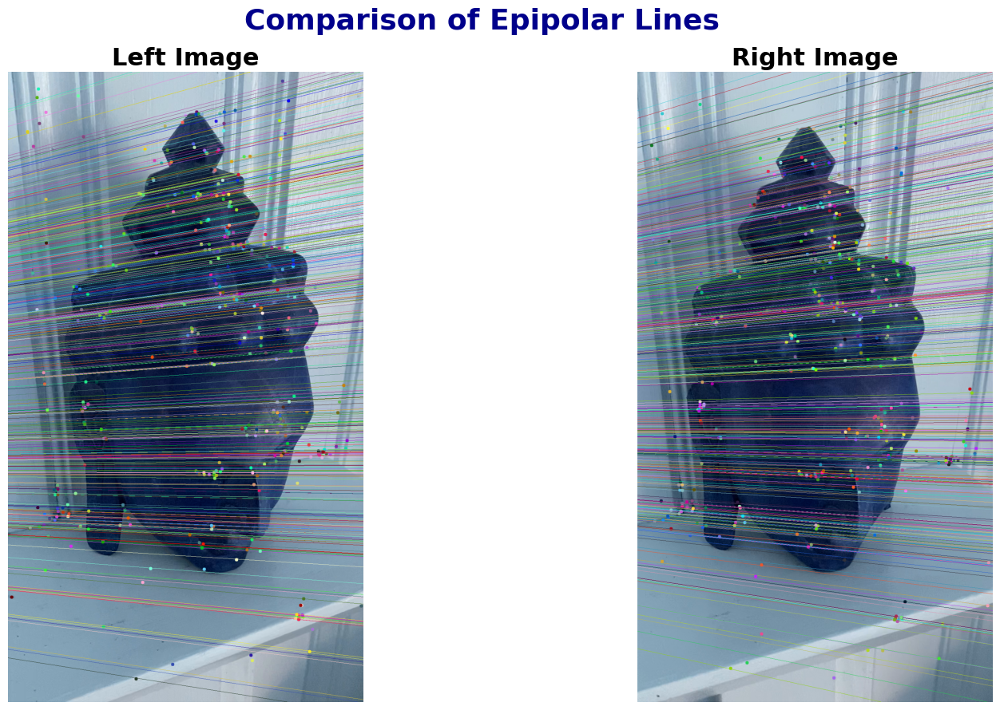

Displaying epipolar lines for image pair: 7 and 8


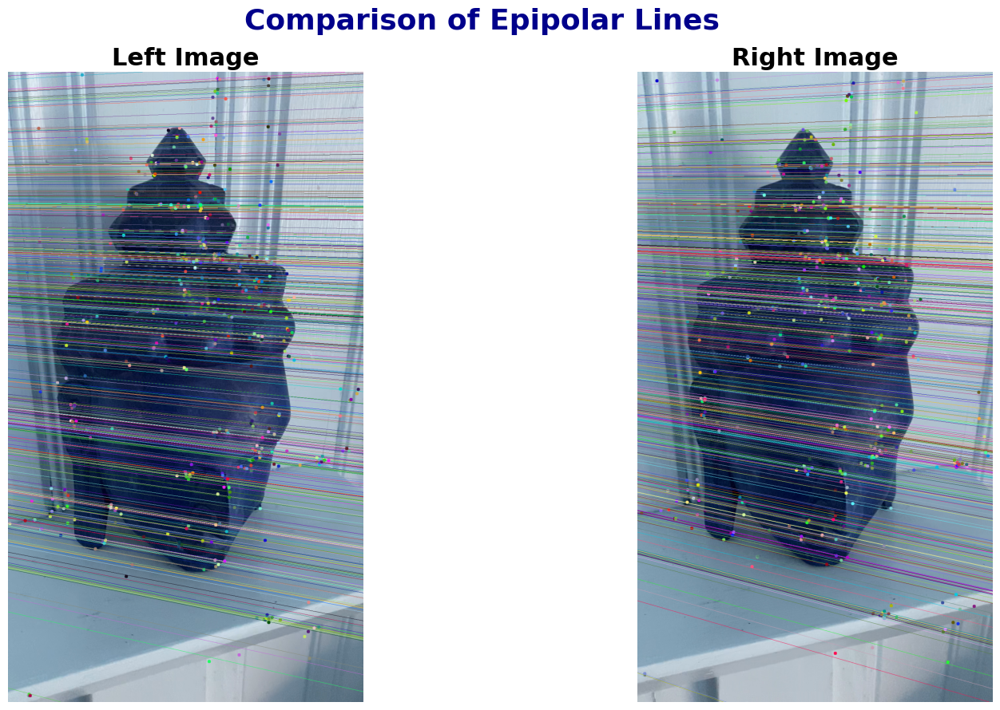

Displaying epipolar lines for image pair: 8 and 9


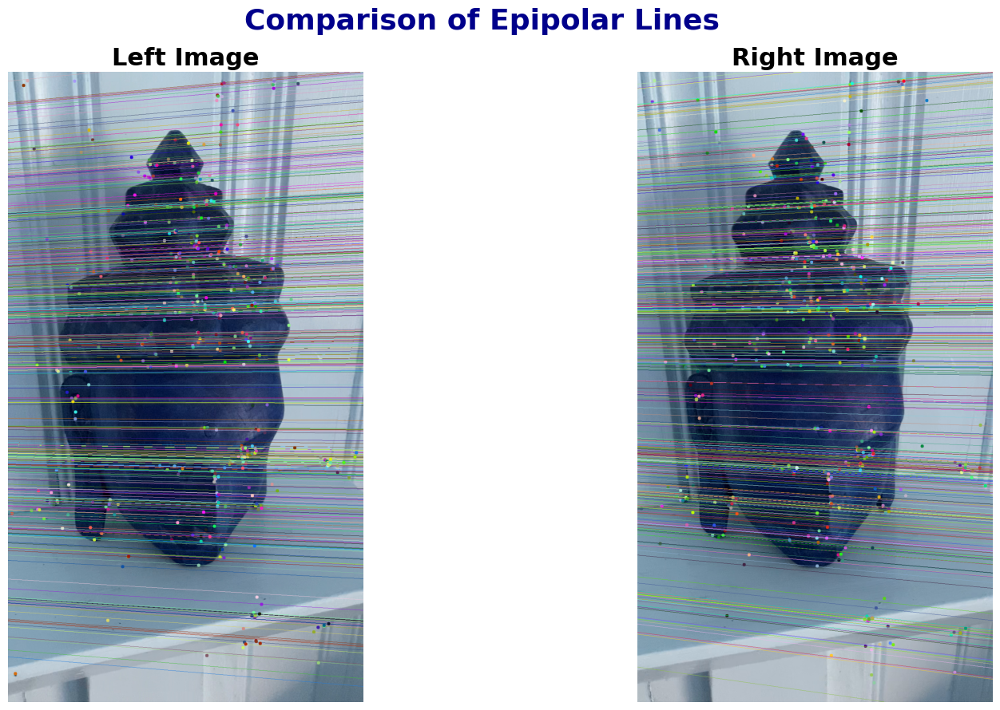

Displaying epipolar lines for image pair: 9 and 10


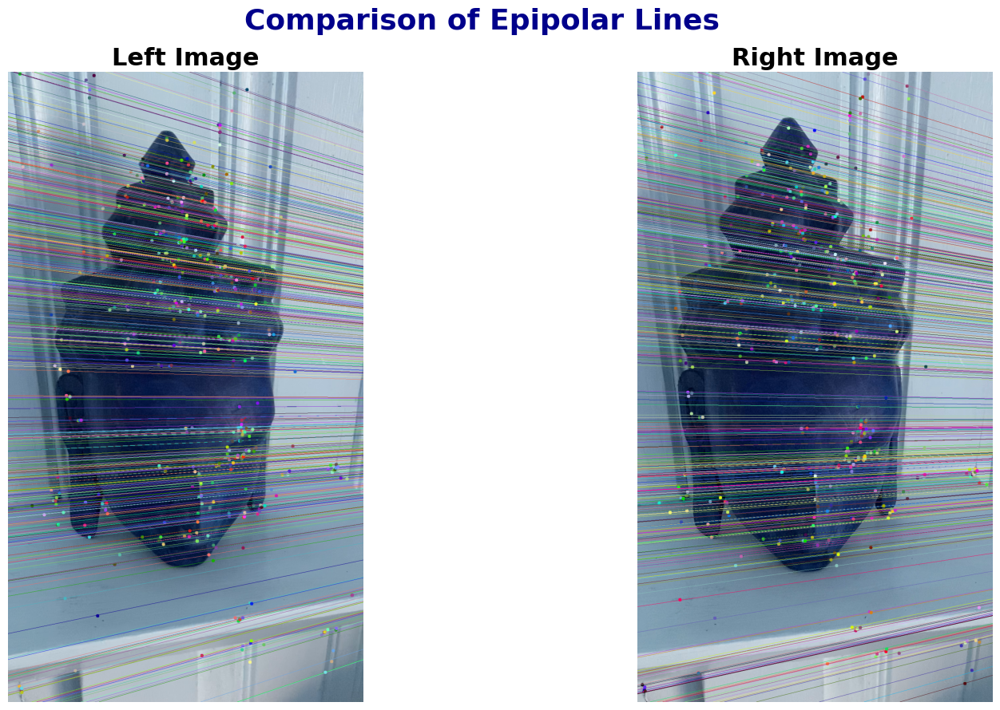

Displaying epipolar lines for image pair: 10 and 11


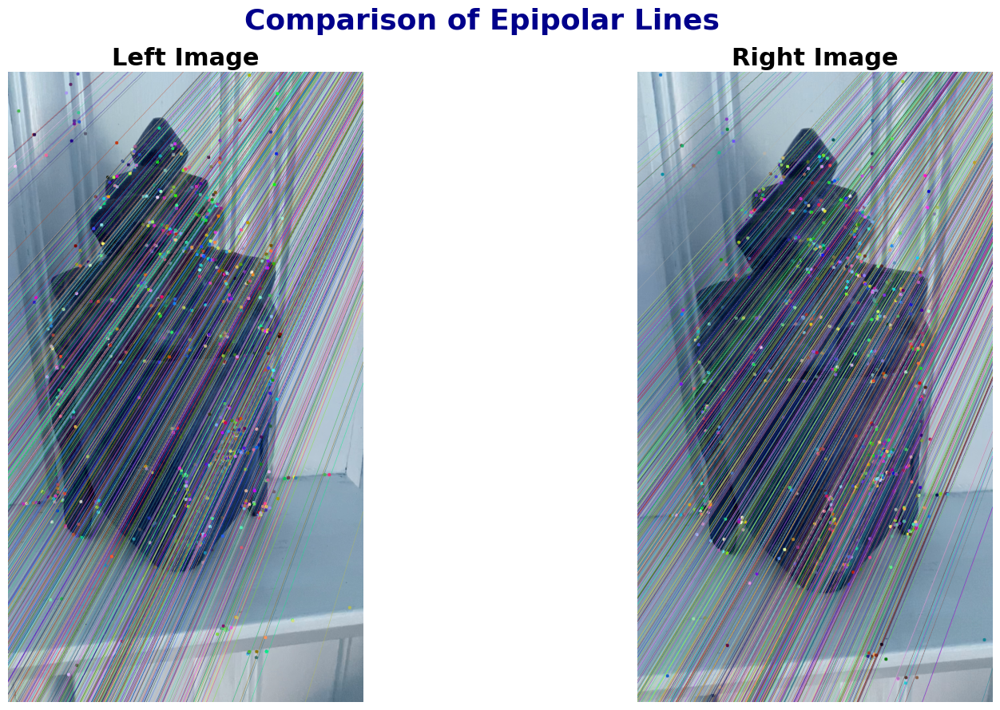

Displaying epipolar lines for image pair: 11 and 12


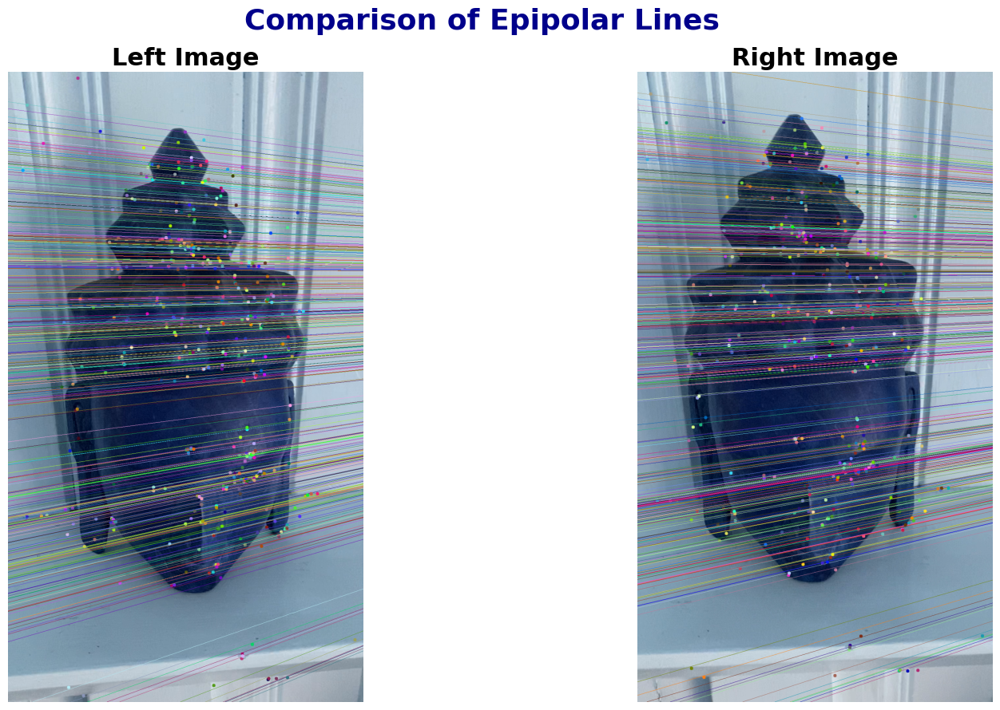

Displaying epipolar lines for image pair: 12 and 13


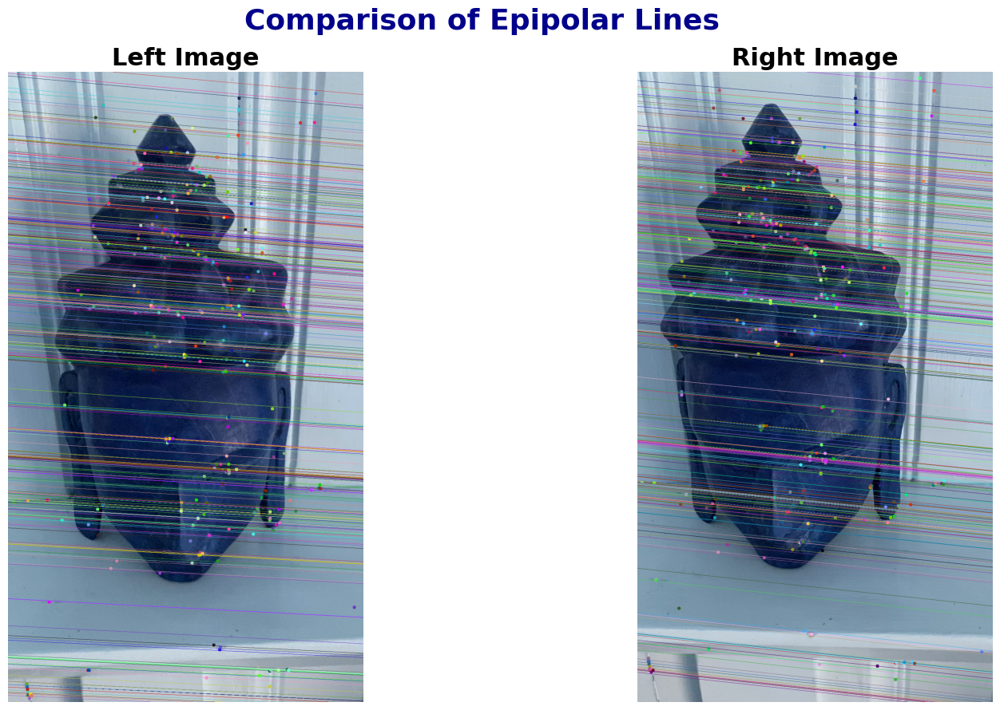

Displaying epipolar lines for image pair: 13 and 14


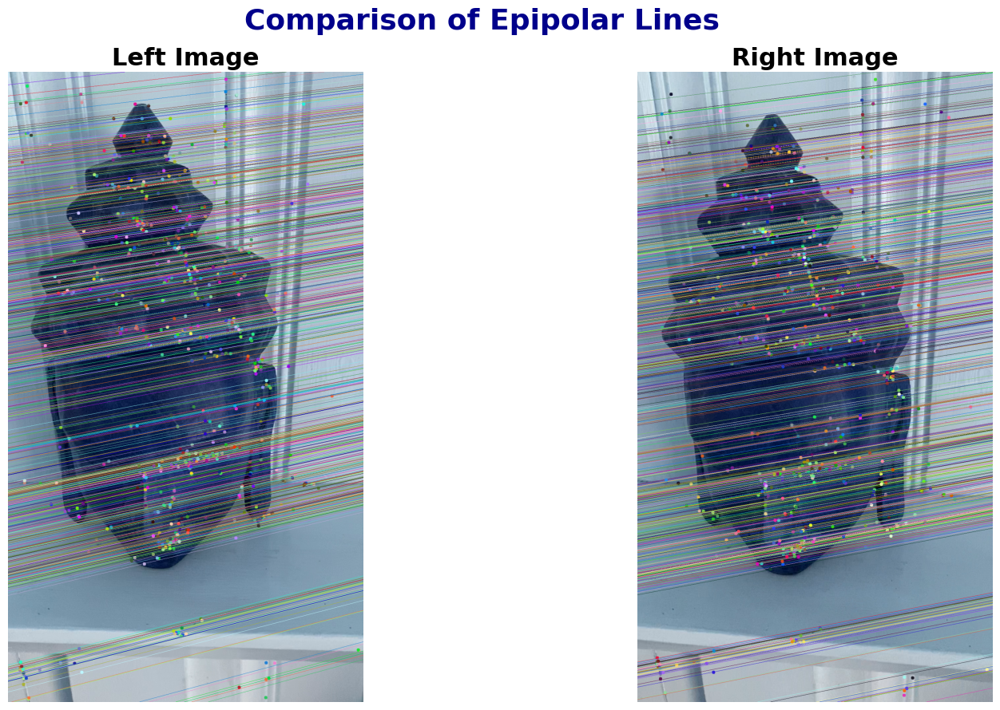

Displaying epipolar lines for image pair: 14 and 15


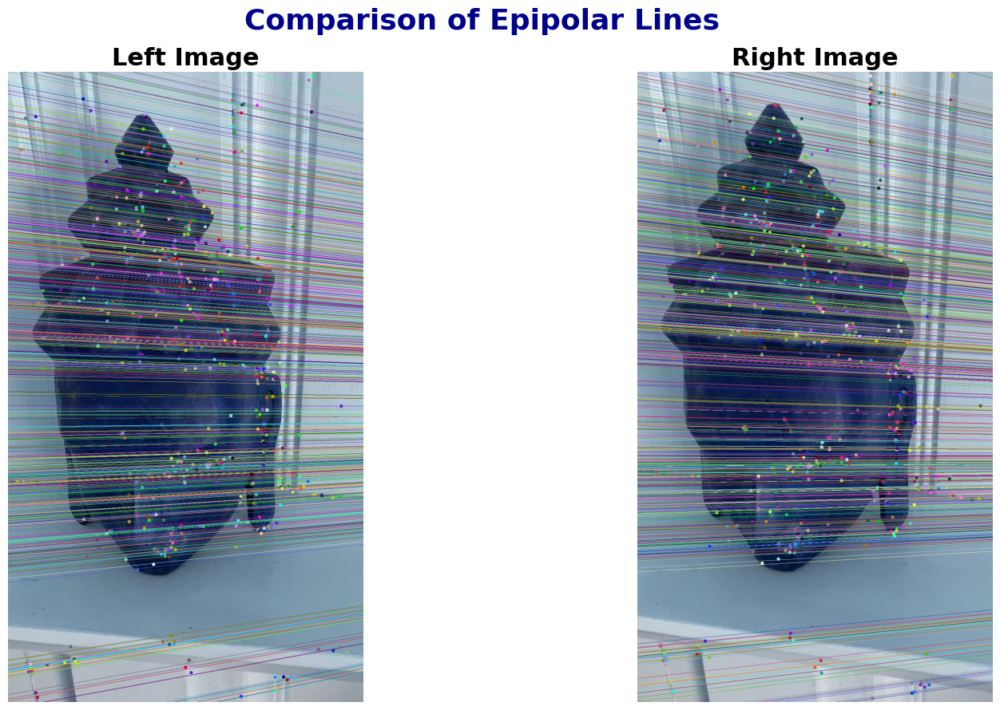

Displaying epipolar lines for image pair: 15 and 16


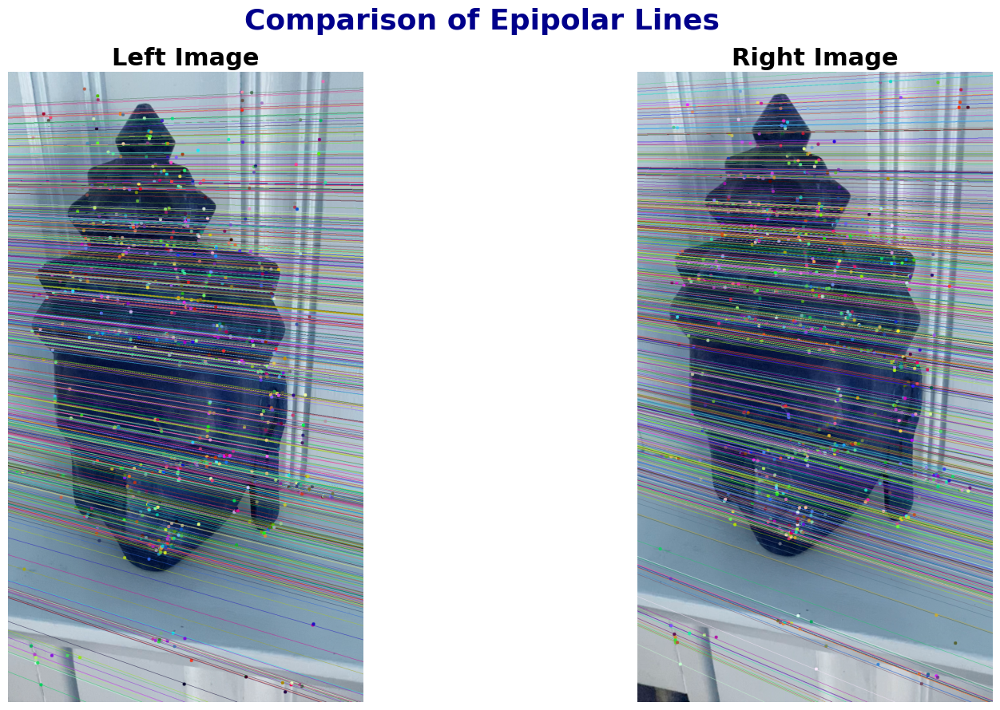

Displaying epipolar lines for image pair: 16 and 17


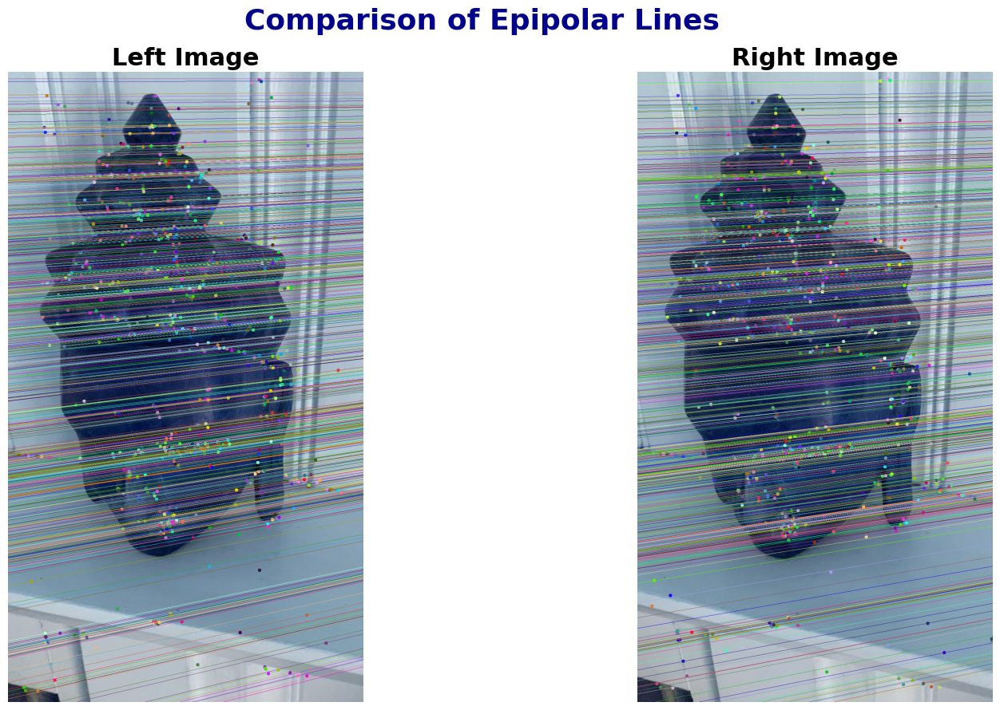

Displaying epipolar lines for image pair: 17 and 18


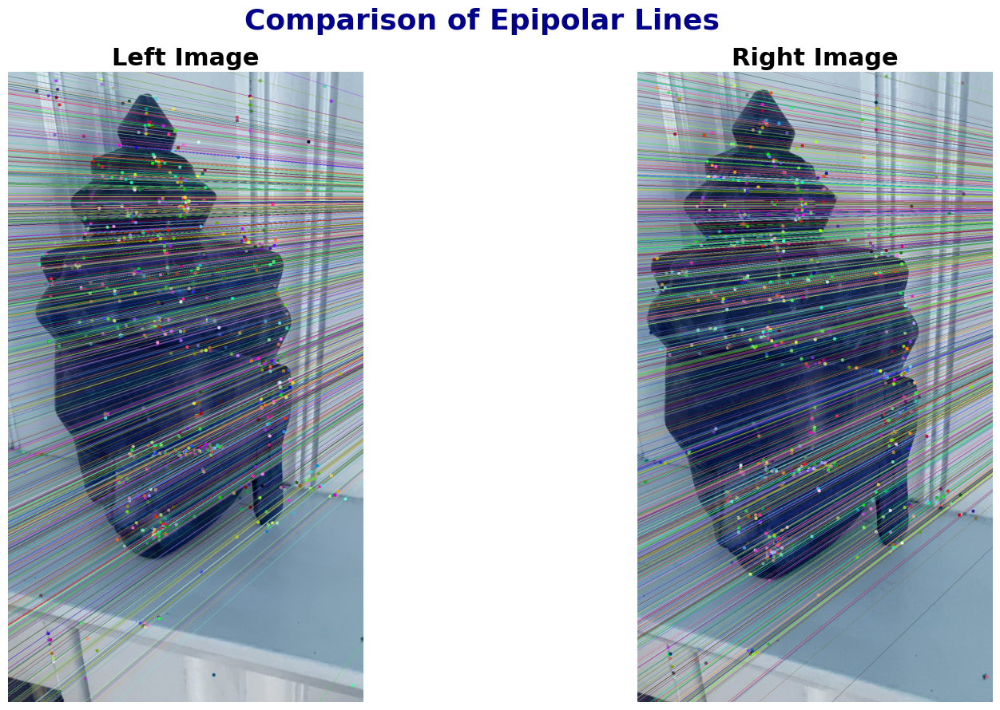

Displaying epipolar lines for image pair: 18 and 19


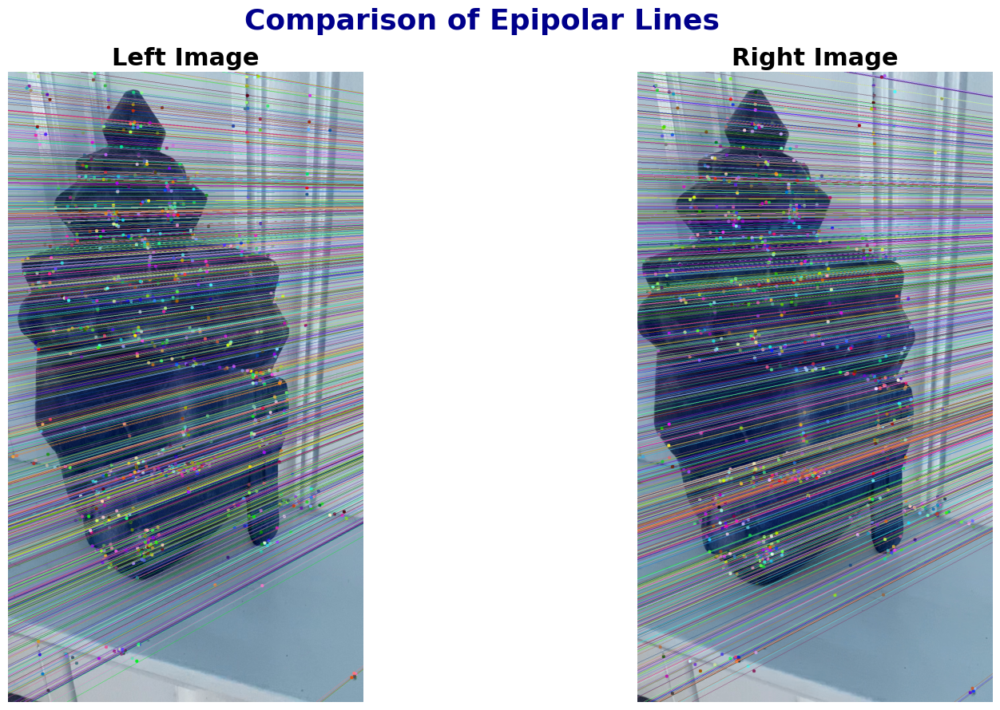

Displaying epipolar lines for image pair: 19 and 20


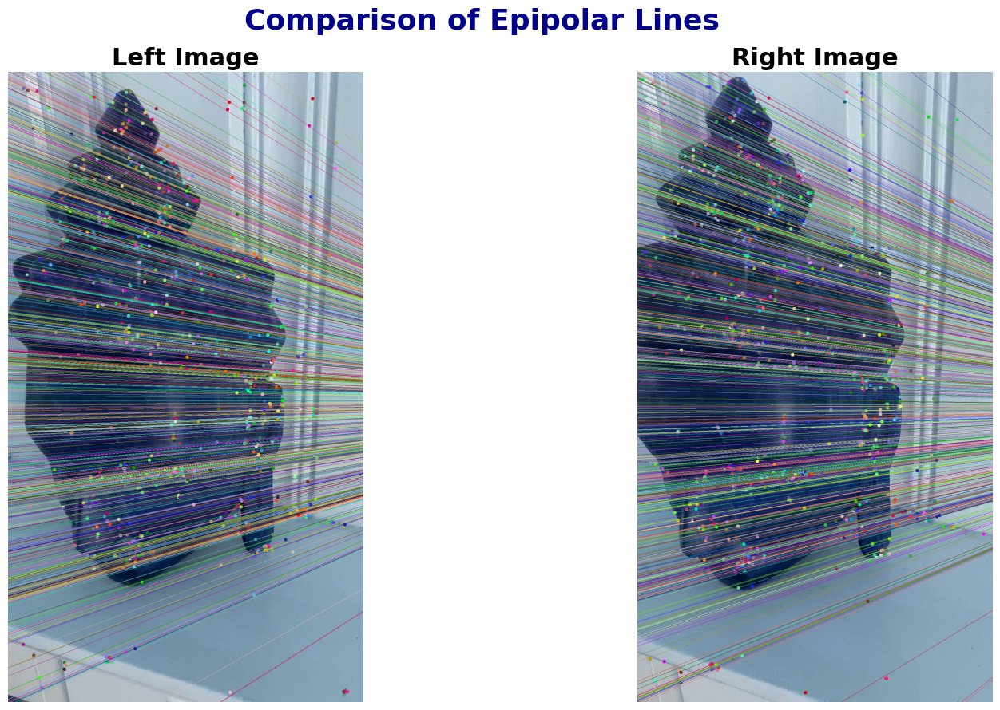

Displaying epipolar lines for image pair: 20 and 21


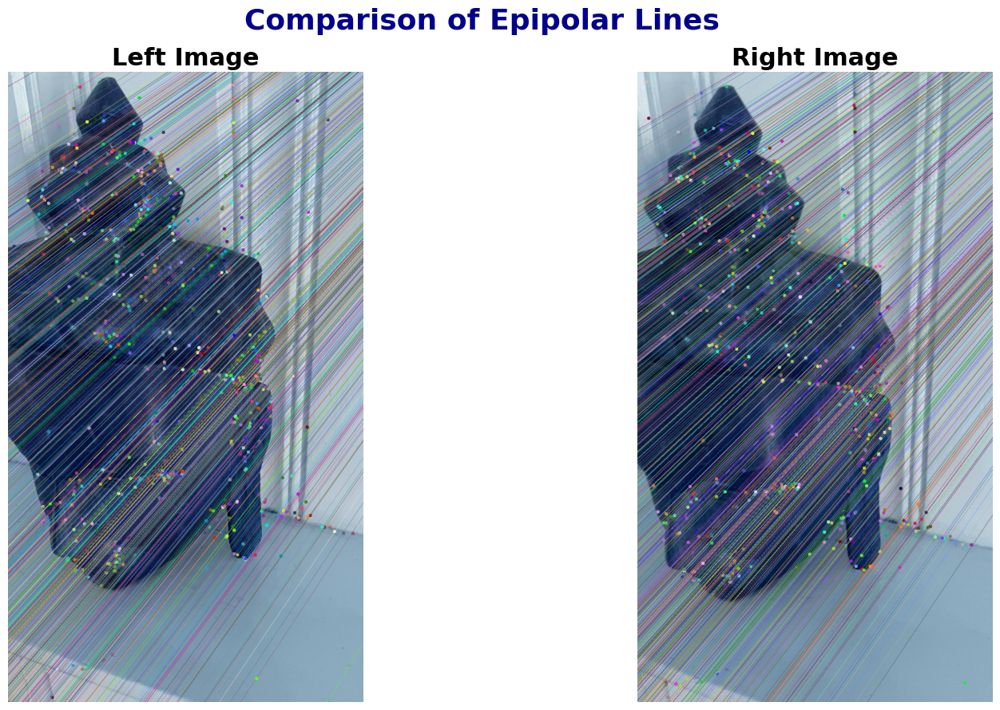

Displaying epipolar lines for image pair: 21 and 22


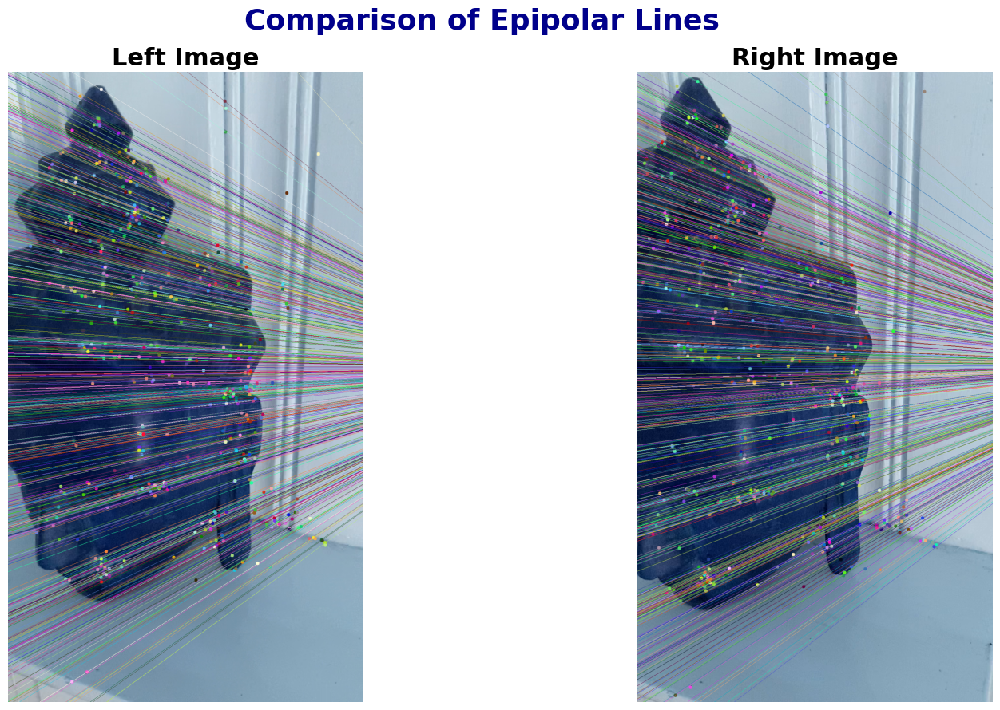

In [9]:
# Initialize lists to store fundamental matrices and inlier points
fundamental_matrices_list = []
inlier_points_list = []

# Iterate through the list of image matches to calculate fundamental matrices
for index in range(len(image) - 1):
    # Check for valid matches before calculating the fundamental matrix
    if matches[index][0].size > 0 and matches[index][1].size > 0:  
        F_matrix, mask, (inliers1, inliers2) = calculate_fundamental_matrix(matches[index][0], matches[index][1])
        # Append the calculated fundamental matrix and inliers to their respective lists
        fundamental_matrices_list.append(F_matrix)
        inlier_points_list.append((inliers1, inliers2))

# Loop through all image pairs to compute and display epipolar lines
for display_index in range(len(image) - 1):
    # Compute the epilines for the left image based on the right image's corresponding points
    epilines1 = cv2.computeCorrespondEpilines(matches[display_index][1].reshape(-1, 1, 2), 2, fundamental_matrices_list[display_index])
    epilines1 = epilines1.reshape(-1, 3)  # Reshape the epilines for drawing
    # Draw the epilines on the left image
    img_left, _ = draw_epilines(np.copy(image[display_index]), np.copy(image[display_index + 1]), epilines1, matches[display_index][0], matches[display_index][1])

    # Compute the epilines for the right image based on the left image's corresponding points
    epilines2 = cv2.computeCorrespondEpilines(matches[display_index][0].reshape(-1, 1, 2), 1, fundamental_matrices_list[display_index])
    epilines2 = epilines2.reshape(-1, 3)  # Reshape the epilines for drawing
    # Draw the epilines on the right image
    img_right, _ = draw_epilines(np.copy(image[display_index + 1]), np.copy(image[display_index]), epilines2, matches[display_index][1], matches[display_index][0])

    # Display the annotated images side by side
    print(f"Displaying epipolar lines for image pair: {display_index + 1} and {display_index + 2}")
    display_results(img_left, img_right) 

### Camera Position Plot

In [10]:
### REFERENCE TAKEN FROM JITESH'S CODE FOR INITAL CAMERA POSITION

def visualize_camera_pose(rotation_matrix, translation_vector, axis, scale_factor=0.25, depth=0.5, face_color='grey'):
    """
    Visualize the camera's pose in the world coordinate system.
    """
    optical_center = -translation_vector  # Camera's optical center in the world frame
    axes_world = np.zeros((3, 6))
    
    # Define positive directions for the camera's X, Y, and Z axes
    axes_world[0, 1], axes_world[1, 3], axes_world[2, 5] = 1, 1, 1
    
    # Transform camera axes to the world coordinate frame
    transformed_axes = rotation_matrix.T @ (axes_world * scale_factor) + optical_center[:, np.newaxis]
    
    # Plot the axes in the 3D plot
    axis.plot3D(xs=transformed_axes[0, :2], ys=transformed_axes[1, :2], zs=transformed_axes[2, :2], c='b')  # X-axis
    axis.plot3D(xs=transformed_axes[0, 2:4], ys=transformed_axes[1, 2:4], zs=transformed_axes[2, 2:4], c='r')     # Y-axis
    axis.plot3D(xs=transformed_axes[0, 4:], ys=transformed_axes[1, 4:], zs=transformed_axes[2, 4:], c='g')     # Z-axis

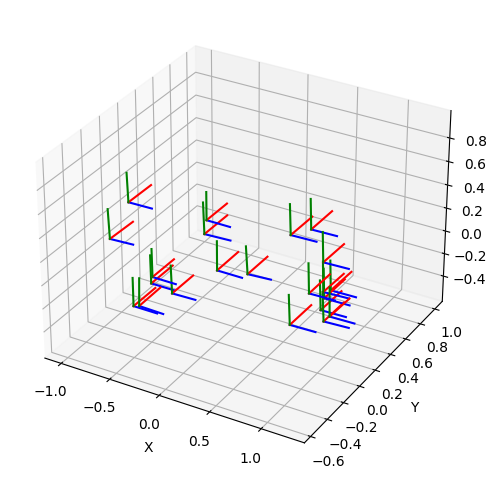

In [11]:
# Initialize the figure for plotting
fig = plt.figure(figsize=(9, 6))
axis = fig.add_subplot(111, projection='3d')
axis.set_xlabel('X')
axis.set_ylabel('Y')
axis.set_zlabel('Z')

# Visualize the origin camera pose
visualize_camera_pose(np.eye(3), np.zeros((3,)), axis, scale_factor=0.25)

# Visualize the poses for each pair of images
for i in range(len(images) - 1):
    matched_points1, matched_points2 = matches[i]
    refined_points1 = matched_points1
    refined_points2 = matched_points2
    
    # Compute the essential matrix and recover pose
    essential_matrix, essential_mask = cv2.findEssentialMat(refined_points1, refined_points2, K, cv2.RANSAC, 0.999, 1.0)
    essential_mask = np.squeeze(essential_mask != 0)
    valid_indices = np.arange(len(refined_points1))[essential_mask]
    
    refined_points1 = refined_points1[essential_mask]
    refined_points2 = refined_points2[essential_mask]
    
    _, relative_rotation, relative_translation, pose_mask = cv2.recoverPose(
        essential_matrix, refined_points2, refined_points1, K
    )
    
    # Plot the camera pose
    visualize_camera_pose(relative_rotation, relative_translation[:, 0], axis, scale_factor=0.25)

# Show the plot
plt.show()

### Optimization for 3D Points and Camera Poses using GTSAM with Bundle Adjustment

#### GTSAM Bundle Adjustment Pipeline:

1. **Initialization**:
   The code initializes a **factor graph** and **initial estimates** for camera poses and 3D landmarks using GTSAM. Noise models for poses, points, and measurements are defined to account for uncertainties in the optimization process. The calibration matrix (`gtsam.Cal3_S2`) is constructed from the intrinsic camera parameters such as focal length and image dimensions.

2. **Processing Initial Matches**:
   The first pair of images is used to compute the **essential matrix** using matched feature points. Inliers are extracted using RANSAC, and the **relative pose (rotation and translation)** is recovered. These estimates initialize the camera pose for the second frame. Triangulation is performed using projection matrices to compute 3D landmarks, which are added to the graph along with prior factors to anchor the first camera and landmark.

3. **Adding Factors for Remaining Images**:
   For each subsequent image pair, the essential matrix and pose are computed similarly. Landmark points are re-triangulated, and a **scale adjustment** ensures depth consistency. Projection factors for matched points are added to the graph, linking the corresponding 2D observations in different frames to the same 3D landmarks. Object indices are used to track associations between features and landmarks.

4. **Optimization**:
   After all matches and measurements are incorporated, the **Levenberg-Marquardt optimizer** refines the factor graph by minimizing the reprojection error. The output includes optimized camera poses, 3D landmarks, and updated noise models. The graph's initial and final errors are logged to evaluate convergence.

5. **Output and Refinement**:
   The pipeline returns the optimized 3D points, factor graph results, and observations for further analysis. This modular approach ensures scalability, enabling efficient bundle adjustment for large datasets by processing image pairs sequentially and handling depth ambiguity through scaling. The code balances computational efficiency with accuracy by leveraging GTSAM's robust framework.

In [12]:
camera_symbol = gtsam.symbol_shorthand.X  # Shorthand for camera poses
landmark_symbol = gtsam.symbol_shorthand.L  # Shorthand for landmarks

In [13]:
def create_gtsam_calibration(image_width, image_height):
    # Create and return GTSAM camera calibration using intrinsic parameters
    return gtsam.Cal3_S2(image_width, image_width, 0.0, image_width/2, image_height/2)

def initialize_factor_graph_and_values():
    # Initialize and return a GTSAM nonlinear factor graph and initial estimates container
    factor_graph = gtsam.NonlinearFactorGraph()
    initial_estimates = gtsam.Values()
    return factor_graph, initial_estimates

def create_noise_models():
    # Create and return noise models for poses, points, and measurements
    pose_noise_model = gtsam.noiseModel.Diagonal.Sigmas([1, 1, 1, 1, 1, 1])
    point_noise_model = gtsam.noiseModel.Isotropic.Sigma(3, 1)
    measurement_noise_model = gtsam.noiseModel.Isotropic.Sigma(2, 1)
    return pose_noise_model, point_noise_model, measurement_noise_model

In [ ]:
### REFERENCE TAKEN FROM ZZ & JITESH'S CODE FOR GTSAM BUNDLE ADJUSTMENT

def process_initial_matches(matches, gp1, gp2, K, initial_estimates, factor_graph, gtsam_calibration, pose_noise_model, point_noise_model, measurement_noise_model):
    # Initialize camera and landmark symbols for GTSAM factor graph
    camera_symbol = gtsam.symbol_shorthand.X
    landmark_symbol = gtsam.symbol_shorthand.L

    # Add the initial camera pose (identity transformation) to initial estimates
    initial_estimates.insert(camera_symbol(0), gtsam.Pose3())

    # Extract initial matches
    matched_points1, matched_points2 = matches[0]
    matched_indices1 = gp1[0]
    matched_indices2 = gp2[0]

    temp_matched_points1 = matched_points1
    temp_matched_points2 = matched_points2

    # Compute the essential matrix and refine the matches based on RANSAC
    essential_matrix, essential_mask = cv2.findEssentialMat(temp_matched_points2, temp_matched_points1, K, cv2.RANSAC, 0.999, 1.0)
    essential_mask = np.squeeze(essential_mask != 0)

    index_mask = np.arange(len(temp_matched_points1))
    index_mask = index_mask[essential_mask]
    temp_matched_points1 = temp_matched_points1[essential_mask]
    temp_matched_points2 = temp_matched_points2[essential_mask]

    # Recover the relative pose (rotation and translation) between the first two views
    _, rotation_matrix, translation_vector, mask = cv2.recoverPose(essential_matrix, temp_matched_points2, temp_matched_points1, K)
    mask = np.squeeze(mask != 0)
    index = index_mask[mask]

    matched_points1 = matched_points1[index]
    matched_points2 = matched_points2[index]
    matched_indices1 = matched_indices1[index]
    matched_indices2 = matched_indices2[index]

    initial_estimates.insert(camera_symbol(1), gtsam.Pose3(gtsam.Rot3(rotation_matrix), gtsam.Point3(translation_vector.flatten())))
    transformation_matrices = []
    projection_matrices = []
    transformation_matrix = np.eye(4)
    transformation_matrix[:3, :] = np.hstack((rotation_matrix, translation_vector))
    projection_matrix = K.dot(np.linalg.inv(transformation_matrix)[:3])
    transformation_matrices.append(transformation_matrix)
    projection_matrices.append(projection_matrix)
    src_projection_matrix = K.dot(np.hstack((np.eye(3), np.zeros((3, 1)))))

    dest_projection_matrix = projection_matrix

    # Triangulate 3D points for the first two images using the relative pose and projection matrices
    triangulated_points = cv2.triangulatePoints(src_projection_matrix, dest_projection_matrix, matched_points1.T, matched_points2.T)
    triangulated_points = (triangulated_points / triangulated_points[-1])[:-1].T
    all_triangulated_points = list(triangulated_points)
    previous_transformation_matrix = transformation_matrix.copy()
    previous_projection_matrix = projection_matrix.copy()

    # Add the second camera pose and the first triangulated point as priors to the factor graph
    factor_graph.add(gtsam.PriorFactorPose3(camera_symbol(0), gtsam.Pose3(), pose_noise_model))
    factor_graph.add(gtsam.PriorFactorPoint3(landmark_symbol(0), all_triangulated_points[0], point_noise_model))
    total_color_observations = []
    total_observations = []
    
    # Return updated matches, transformations, projection matrices, and triangulated points
    return (matched_points1, matched_points2, matched_indices1, matched_indices2, all_triangulated_points,
            previous_transformation_matrix, previous_projection_matrix, total_color_observations, total_observations)

def compute_sift_features(images):
    # Initialize lists to store keypoints, descriptors, and object indices for each image
    keypoints_list = []
    descriptors_list = []
    obj_indices_list = []

    # Configure the SIFT detector with specific parameters
    sift_detector = cv2.SIFT_create(nfeatures=5000, nOctaveLayers=16, contrastThreshold=0.025, edgeThreshold=10, sigma=1.4)

    # Extract keypoints and descriptors for each image in the list
    for img in images:
        keypoints, descriptors = sift_detector.detectAndCompute(img, None)
        keypoints_list.append(np.array(keypoints))  # Store keypoints as an array
        descriptors_list.append(np.array(descriptors))  # Store descriptors as an array
        obj_indices_list.append(np.full(len(keypoints), -1, int))  # Initialize object indices to -1

    # Return extracted features and object indices for all images
    return keypoints_list, descriptors_list, obj_indices_list


def process_remaining_images(images, matches, gp1, gp2, K, initial_estimates, factor_graph, gtsam_calibration,
                             measurement_noise_model, obj_indices_list, all_triangulated_points, total_color_observations,
                             total_observations, previous_transformation_matrix, previous_projection_matrix):
    camera_symbol = gtsam.symbol_shorthand.X
    landmark_symbol = gtsam.symbol_shorthand.L

    # Loop through each image pair starting from the second image
    for i in range(1, len(images) - 1):
        # Get matches for the current image pair
        matched_points1_all, matched_points2_all = matches[i]
        matched_indices1_all = gp1[i]
        matched_indices2_all = gp2[i]

        # Filter matches using the essential matrix and mask outliers
        temp_matched_points1_all = matched_points1_all
        temp_matched_points2_all = matched_points2_all
        essential_matrix_all, essential_mask_all = cv2.findEssentialMat(temp_matched_points2_all, temp_matched_points1_all, K, cv2.RANSAC, 0.999, 1.0)
        essential_mask_all = np.squeeze(essential_mask_all != 0)
        index_mask_all = np.arange(len(temp_matched_points1_all))
        index_mask_all = index_mask_all[essential_mask_all]
        temp_matched_points1_all = temp_matched_points1_all[essential_mask_all]
        temp_matched_points2_all = temp_matched_points2_all[essential_mask_all]

        # Recover relative pose between the two images
        _, rotation_matrix_all, translation_vector_all, mask_all = cv2.recoverPose(essential_matrix_all, temp_matched_points2_all, temp_matched_points1_all, K)
        mask_all = np.squeeze(mask_all != 0)
        index_all = index_mask_all[mask_all]
        matched_points1_all = matched_points1_all[index_all]
        matched_points2_all = matched_points2_all[index_all]
        matched_indices1_all = matched_indices1_all[index_all]
        matched_indices2_all = matched_indices2_all[index_all]

        # Update transformation and projection matrices for the current image pair
        transformation_matrix = np.eye(4)
        transformation_matrix[:3, :] = (np.hstack((rotation_matrix_all, translation_vector_all))).dot(previous_transformation_matrix)
        projection_matrix = K.dot(np.linalg.inv(transformation_matrix)[:3])

        # compute triangulated points
        obj_indices1 = obj_indices_list[i]
        obj_indices2 = obj_indices_list[i + 1]
        img1_normalized = images[i]
        img2_normalized = images[i + 1]
        matched_i1_points = []
        matched_i2_points = []
        matched_object_points = []
        for src_point, dst_point, src_point_index in zip(matched_points1_all, matched_points2_all, matched_indices1_all):
            obj_idx = obj_indices1[src_point_index]
            if obj_idx != -1:
                matched_i1_points.append(src_point)
                matched_i2_points.append(dst_point)
                matched_object_points.append(all_triangulated_points[obj_idx] / (total_observations[obj_idx] - 1))
        matched_i1_points = np.array(matched_i1_points)
        matched_i2_points = np.array(matched_i2_points)
        matched_object_points = np.array(matched_object_points)

        # Scaling to adjust translation
        triangulated_points = cv2.triangulatePoints(previous_projection_matrix, projection_matrix, matched_i1_points.T, matched_i2_points.T)
        triangulated_points = (triangulated_points / triangulated_points[-1])[:-1].T
        scale = 0
        for m_obj_p, object_point in zip(matched_object_points, triangulated_points):
            scale += cv2.norm(m_obj_p) / cv2.norm(object_point)
        scale /= len(triangulated_points)
        translation_vector_all = translation_vector_all * scale

        # Using scaled translation to compute new transformation matrix
        transformation_matrix = np.eye(4)
        transformation_matrix[:3, :] = (np.hstack((rotation_matrix_all, translation_vector_all))).dot(previous_transformation_matrix)
        initial_estimates.insert(camera_symbol(i + 1), gtsam.Pose3(gtsam.Rot3(transformation_matrix[:3, :3]), gtsam.Point3(transformation_matrix[:3, 3])))
        projection_matrix = K.dot(np.linalg.inv(transformation_matrix)[:3])
        triangulated_points = cv2.triangulatePoints(previous_projection_matrix, projection_matrix, matched_points1_all.T, matched_points2_all.T)
        triangulated_points = (triangulated_points / triangulated_points[-1])[:-1].T
        previous_transformation_matrix = transformation_matrix.copy()
        previous_projection_matrix = projection_matrix.copy()
        rint_src_point = np.rint(matched_points1_all).astype(int)
        rint_dst_point = np.rint(matched_points2_all).astype(int)
        curr_obj_idx = len(total_observations)

        # Update factor graph with current pose and triangulated points
        for src_point, dst_point, src_point_index, dst_point_index, object_point, rint_src_p, rint_dst_p in zip(
                matched_points1_all, matched_points2_all, matched_indices1_all, matched_indices2_all, triangulated_points, rint_src_point, rint_dst_point):
            obj_idx = obj_indices1[src_point_index]
            if obj_idx == -1: # New landmark
                obj_idx = curr_obj_idx
                all_triangulated_points.append(object_point)
                total_color_observations.append(
                    img1_normalized[rint_src_p[1], rint_src_p[0]] + img2_normalized[rint_dst_p[1], rint_dst_p[0]])
                total_observations.append(2)
                obj_indices1[src_point_index] = obj_indices2[dst_point_index] = obj_idx
                curr_obj_idx += 1
            else: # Existing landmark
                obj_indices2[dst_point_index] = obj_idx
                all_triangulated_points[obj_idx] = all_triangulated_points[obj_idx] + object_point
                total_color_observations[obj_idx] = total_color_observations[obj_idx] + img2_normalized[rint_dst_p[1], rint_dst_p[0]]
                total_observations[obj_idx] = total_observations[obj_idx] + 1
            factor_graph.add(gtsam.GenericProjectionFactorCal3_S2(src_point, measurement_noise_model, camera_symbol(i), landmark_symbol(obj_idx), gtsam_calibration))
            factor_graph.add(gtsam.GenericProjectionFactorCal3_S2(dst_point, measurement_noise_model, camera_symbol(i + 1), landmark_symbol(obj_idx), gtsam_calibration))

    # Return updated transformation matrices, observations, and triangulated points
    return previous_transformation_matrix, previous_projection_matrix, total_color_observations, total_observations

In [15]:
def add_landmarks_to_initial_estimates(all_triangulated_points, total_observations, initial_estimates):
    # Add triangulated 3D landmarks to the initial GTSAM estimates for optimization.
    landmark_symbol = gtsam.symbol_shorthand.L
    total_observations_array = np.array([total_observations, total_observations, total_observations]).T
    total_object_points = np.array(all_triangulated_points) / (total_observations_array - 1)
    for obj_idx, obj_point in enumerate(total_object_points):
        initial_estimates.insert(landmark_symbol(obj_idx), gtsam.Point3(obj_point))
    return total_object_points

def optimize_factor_graph(factor_graph, initial_estimates):
    # Perform bundle adjustment by optimizing the factor graph.
    params = gtsam.LevenbergMarquardtParams()
    optimizer = gtsam.LevenbergMarquardtOptimizer(factor_graph, initial_estimates, params)
    print('Optimizing:')
    result = optimizer.optimize()
    print('initial error = {}'.format(factor_graph.error(initial_estimates)))
    print('final error = {}'.format(factor_graph.error(result)))
    return result

def run_sfm_pipeline(images, matches, gp1, gp2, K):
    image_width = images[0].shape[1]
    image_height = images[0].shape[0]

    gtsam_calibration = create_gtsam_calibration(image_width, image_height)
    factor_graph, initial_estimates = initialize_factor_graph_and_values()
    pose_noise_model, point_noise_model, measurement_noise_model = create_noise_models()
    camera_symbol = gtsam.symbol_shorthand.X
    landmark_symbol = gtsam.symbol_shorthand.L

    # Process initial matches and get initial estimates
    (matched_points1, matched_points2, matched_indices1, matched_indices2, all_triangulated_points,
     previous_transformation_matrix, previous_projection_matrix, total_color_observations, total_observations) = process_initial_matches(
        matches, gp1, gp2, K, initial_estimates, factor_graph, gtsam_calibration, pose_noise_model, point_noise_model, measurement_noise_model)

    # Compute SIFT features
    keypoints_list, descriptors_list, obj_indices_list = compute_sift_features(images)

    # For the first image pair, update object indices and add factors
    obj_indices1 = obj_indices_list[0]
    obj_indices2 = obj_indices_list[1]
    img1_normalized = images[0]
    img2_normalized = images[1]
    img1_rounded_int = np.rint(matched_points1).astype(int)
    img2_rounded_int = np.rint(matched_points2).astype(int)

    for obj_idx, (src_point, dst_point, src_point_index, dst_point_index, obj_pt, rint_src_point, rint_dst_point) in enumerate(
            zip(matched_points1, matched_points2, matched_indices1, matched_indices2, all_triangulated_points, img1_rounded_int, img2_rounded_int)):
        obj_indices1[src_point_index] = obj_idx
        obj_indices2[dst_point_index] = obj_idx

        factor_graph.add(gtsam.GenericProjectionFactorCal3_S2(src_point, measurement_noise_model, camera_symbol(0), landmark_symbol(obj_idx), gtsam_calibration))
        factor_graph.add(gtsam.GenericProjectionFactorCal3_S2(dst_point, measurement_noise_model, camera_symbol(1), landmark_symbol(obj_idx), gtsam_calibration))
        total_color_observations.append(
            img1_normalized[rint_src_point[1], rint_dst_point[0]] + img2_normalized[rint_dst_point[1], rint_src_point[0]])
        total_observations.append(2)

    # Process remaining images
    previous_transformation_matrix, previous_projection_matrix, total_color, total_obs = process_remaining_images(
        images, matches, gp1, gp2, K, initial_estimates, factor_graph, gtsam_calibration, measurement_noise_model,
        obj_indices_list, all_triangulated_points, total_color_observations, total_observations,
        previous_transformation_matrix, previous_projection_matrix)

    # Add landmarks to initial estimates
    total_object_points = add_landmarks_to_initial_estimates(all_triangulated_points, total_observations, initial_estimates)

    # Optimize the factor graph
    result = optimize_factor_graph(factor_graph, initial_estimates)

    return total_object_points, result, total_color, total_obs

In [16]:
## RUN THE SFM GTSAM PIPELINE
total_object_points, optimized_result, total_color, total_obs = run_sfm_pipeline(image, matches, gp1, gp2, K)

Optimizing:
initial error = 346484861.8959357
final error = 298608351.6851707


## Visualization of 3D Reconstruction SFM - 3D Point Cloud and Camera Poses

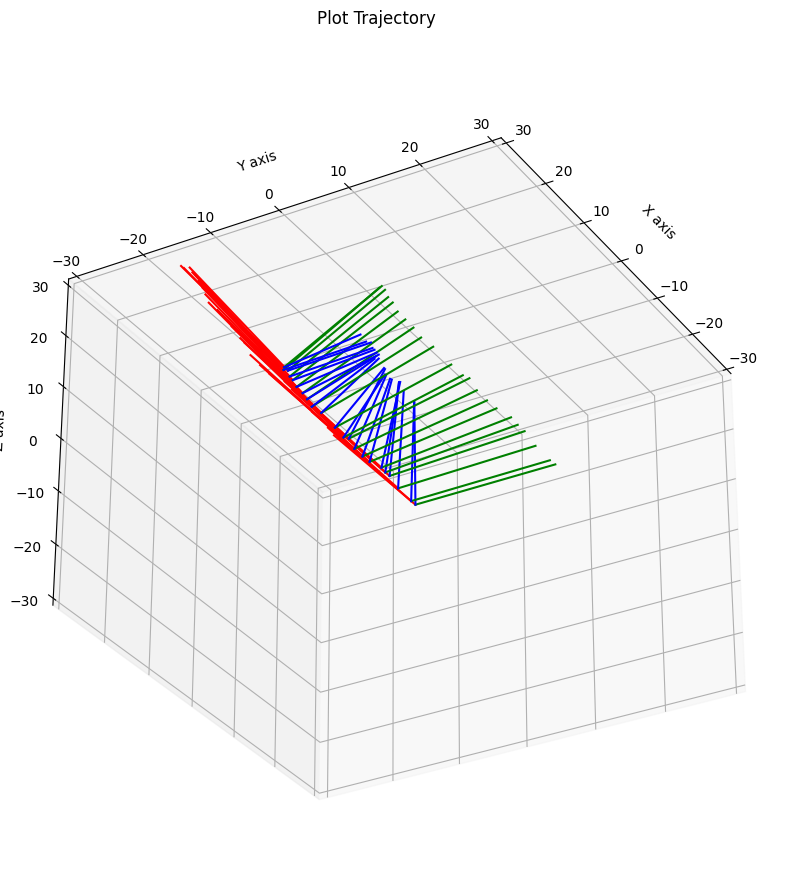

In [17]:
# Plot the camera poses after optimization

figure_3d = plt.figure(figsize=(15, 10))
axis_3d = figure_3d.add_subplot(111, projection='3d')

# Plot the optimized trajectory
gtsam.utils.plot.plot_trajectory(1, optimized_result, scale=20)

# Set the 3D plot limits
axis_3d.set_xlim3d(-30, 30)
axis_3d.set_ylim3d(-30, 30)
axis_3d.set_zlim3d(-30, 30)

# Adjust the view angle
axis_3d.view_init(elev=-30, azim=30)

# Display the plot
plt.show()

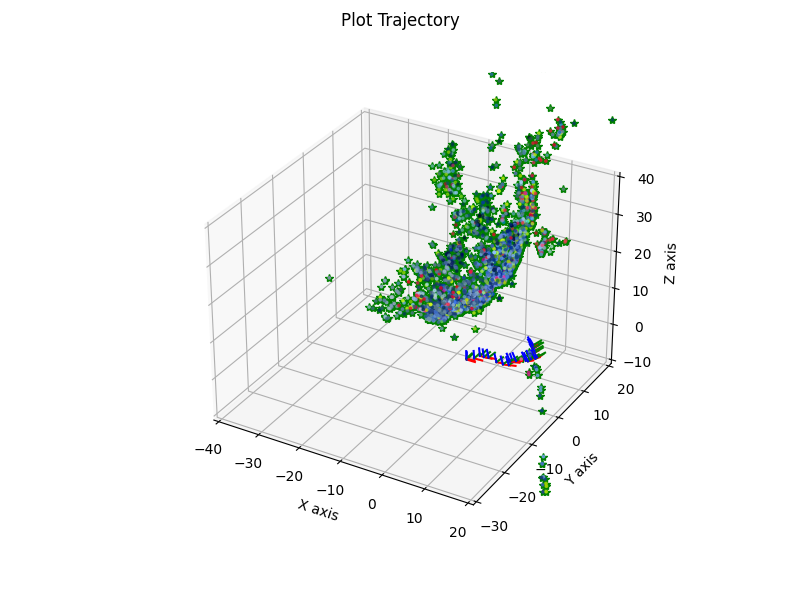

In [18]:
# %matplotlib notebook
%matplotlib ipympl
import matplotlib.pyplot as plt 

# Convert total_color to a NumPy array for element-wise operations
total_color_array = np.array(total_color)

fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(projection='3d')

final_object_points = []
for index in range(len(total_object_points)):
    final_object_points.append(optimized_result.atPoint3(landmark_symbol(index)))

final_object_points = np.array(final_object_points)

# Use the converted total_color_array for scatter plot
ax.scatter(final_object_points[:, 0],
           final_object_points[:, 1], final_object_points[:, 2], c=total_color_array / 255., s=3)

gtsam.utils.plot.plot_3d_points(1, optimized_result)
gtsam.utils.plot.plot_trajectory(1, optimized_result, scale=2)
gtsam.utils.plot.set_axes_equal(1)

ax.set_xlim3d(-40, 20)
ax.set_ylim3d(-30, 20)
ax.set_zlim3d(-10, 40)

plt.show()


In [19]:
import open3d as o3d
import numpy as np

# Convert final_object_points and colors to Open3D PointCloud
def create_point_cloud(points, colors):
    point_cloud = o3d.geometry.PointCloud()
    point_cloud.points = o3d.utility.Vector3dVector(points)
    point_cloud.colors = o3d.utility.Vector3dVector(colors / 255.0)  # Normalize colors
    return point_cloud

# Function to create a camera frame in Open3D at a given pose
def create_camera_frame(pose, scale=0.5):
    camera_frame = o3d.geometry.TriangleMesh.create_coordinate_frame(size=scale)
    camera_frame.translate(pose[:3, 3])
    camera_frame.rotate(pose[:3, :3], center=pose[:3, 3])
    return camera_frame

# Retrieve and format final points
final_object_points = []
for index in range(len(total_object_points)):
    final_object_points.append(optimized_result.atPoint3(landmark_symbol(index)))
final_object_points = np.array(final_object_points) 

# Convert total_color and total_observations to NumPy arrays
total_color_array = np.array(total_color)
total_observations_array = np.array(total_obs)

# Expand total_observations_array to match the RGB dimensions
total_observations_expanded = np.repeat(total_observations_array[:, np.newaxis], 3, axis=1)

# Normalize total_color by total_observations
colors = np.flip(total_color_array / total_observations_expanded, axis=0).astype(np.uint8)

# Create point cloud
point_cloud = create_point_cloud(final_object_points, colors)

# Create camera frames from GTSAM result poses
camera_frames = []
for i in range(len(image)):
    pose = optimized_result.atPose3(camera_symbol(i)).matrix() 
    camera_frames.append(create_camera_frame(pose))

# Open3D visualization
o3d.visualization.draw_geometries([point_cloud] + camera_frames,
                                  zoom=0.8,
                                  front=[0, 0, -1],
                                  lookat=[0, 0, 0],
                                  up=[0, 1, 0])



Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


Thus, we have recovered the 3D Point Cloud and the camera poses successfully using the GTSAM Bundle Adjustment optimzation. Since the Open3D viewer does not save any output in .ipynb, I have taken screenshots of my 3D Point cloud and poses and uploaded it in a folder on GITLAB. I am loading those images in the below cell.

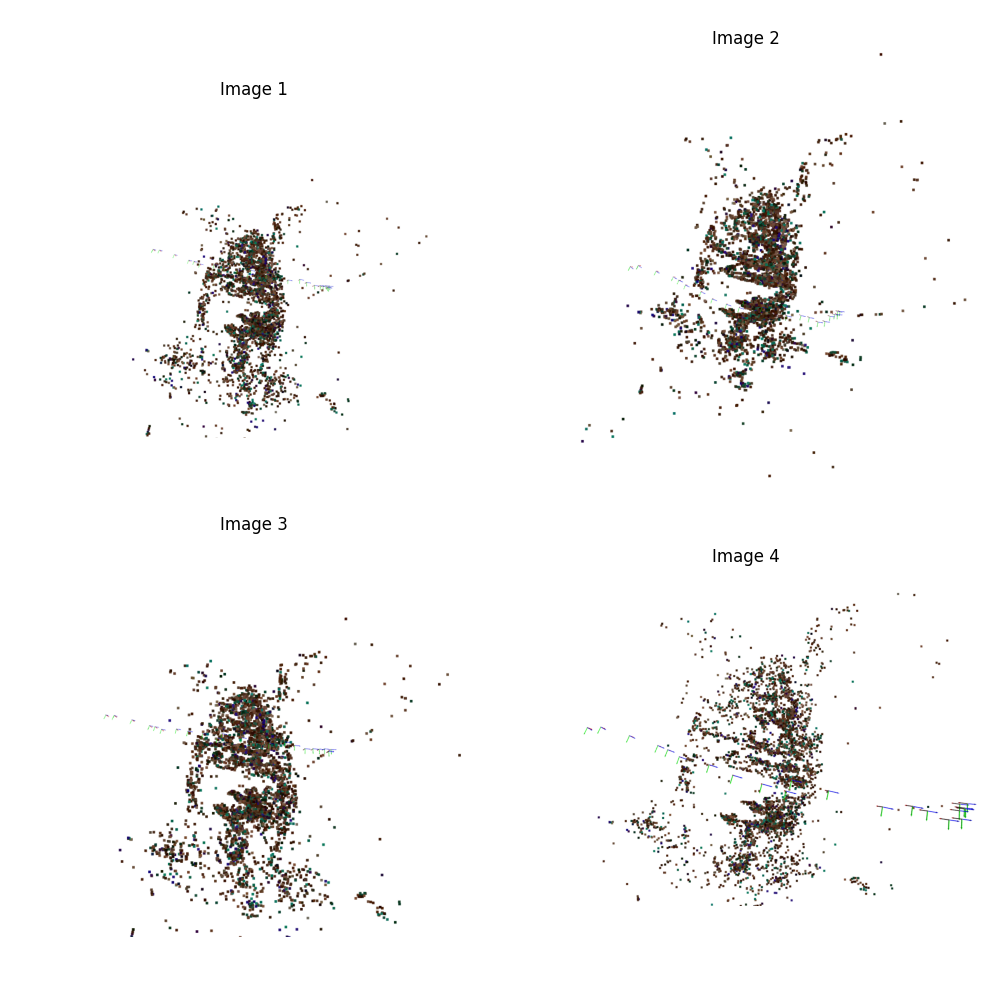

In [ ]:
### LOADING THE OPEN3D VIEWER OUTPUT IN THIS CELL 

folder_path = '3D Recon-SFM' 
images = load_images_from_folder(folder_path) 

# Extract image arrays into a separate variable
image = [img[1] for img in images]

# Calculate the number of rows and columns for a 2x2 grid
num_images = len(image)
rows = 2
cols = math.ceil(num_images / rows)  # Calculate columns based on the number of images

# Display images in a 2x2 grid
fig, axes = plt.subplots(rows, cols, figsize=(10, 10))  # Adjust figure size as needed

for i, ax in enumerate(axes.flat):  # Flatten axes for easy iteration
    if i < num_images:
        ax.imshow(image[i], cmap='gray')  # Display each image
        ax.axis('off')  # Turn off axes
        ax.set_title(f"Image {i+1}")  # Optional: Title for each image
    else:
        ax.axis('off')  # Hide unused subplots

plt.tight_layout()
plt.show()